In [1]:
setwd("~/projects/next_gen_attribution/src/analysis/R/pg")

source("~/R_connector/libraries.R")
#mozart <- connToEDW(dataBase = "Mozart", connType = 'normal', user = 'pgurican', pass=trimws(read_file("~/R_connector/p.txt")))
hopper <- connToEDW(dataBase = "Hopper", connType = 'normal', user = 'pgurican', pass=trimws(read_file("~/R_connector/p.txt")))

Loading required package: DBI
Loading required package: rJava
------------------------------------------------------------------------------
data.table + dplyr code now lives in dtplyr.
Please library(dtplyr)!
------------------------------------------------------------------------------

Attaching package: ‘dplyr’

The following objects are masked from ‘package:data.table’:

    between, first, last

The following objects are masked from ‘package:stats’:

    filter, lag

The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



In [3]:
mktng_events <- dbGetQuery(conn = hopper, "select * from P_attribution_T.pg_agg_mktng_evts_v3;")

In [4]:
mktng_events <- mktng_events %>% select(-dt)

In [55]:
head(mktng_events)

event_dt,channel_id,event_type_id,experience_level2,device_level2,no_events,channel_name
2017-06-20,NA,1,Apps: iPhone,Mobile: Phone,20,NA
2017-06-01,NA,1,Apps: iPad,Mobile: Tablet,10,NA
2017-05-21,NA,1,Apps: Android,Mobile: Unknown,5,NA
2017-06-22,NA,1,Apps: Android,Mobile: Tablet,1,NA
2017-06-03,NA,1,Apps: iPad,Mobile: Tablet,4,NA
2017-05-04,NA,1,Apps: Android,Mobile: Unknown,1,NA


In [6]:
mktng_events$event_dt <- as.Date(mktng_events$event_dt)
mktng_events$channel_id <- as.factor(mktng_events$channel_id)
mktng_events$event_type_id <- as.factor(mktng_events$event_type_id)
mktng_events$experience_level2 <- as.factor(mktng_events$experience_level2)
mktng_events$device_level2 <- as.factor(mktng_events$device_level2)

In [7]:
channels_lookup <- read.csv(file = "channels_lookup.csv")
channels_lookup$channel_id <- as.factor(channels_lookup$channel_id)
channels_lookup$channel_name <- as.factor(channels_lookup$channel_name)

mktng_events <- left_join(mktng_events, channels_lookup)

Joining, by = "channel_id"
Warning message in left_join_impl(x, y, by$x, by$y, suffix$x, suffix$y):
“joining factors with different levels, coercing to character vector”

In [8]:
library(htmlwidgets)
library(highcharter)
library(plotly)

Highcharts (www.highcharts.com) is a Highsoft software product which is
not free for commercial and Governmental use

Attaching package: ‘plotly’

The following object is masked from ‘package:ggplot2’:

    last_plot

The following object is masked from ‘package:stats’:

    filter

The following object is masked from ‘package:graphics’:

    layout



In [57]:
events_by_date <- mktng_events %>% 
                                    select(-event_type_id) %>% 
                                    group_by(event_dt, channel_name) %>% 
                                    summarise(no_events = sum(no_events))

In [17]:
events_by_date <- transform(events_by_date,
          channel_name=plyr::revalue(channel_name,c("NULL"="Unknown")))

hc <- hchart(events_by_date,
       "line",
       hcaes(x = event_dt,
             y = no_events, 
             group = channel_name
             #color = channel_id, 
             #fill = channel_id
            )) 



IRdisplay::display(hc)

HTML widgets cannot be represented in plain text (need html)

In [35]:
for (x in levels(events_by_date$channel_name))
    {
    print(x)
}

[1] "Display"
[1] "epn"
[1] "Exclusion"
[1] "marketing_emails"
[1] "Natural Search"
[1] "Natural Search - Gbase"
[1] "NULL"
[1] "Others"
[1] "Paid Search"
[1] "Paid Search - Brand"
[1] "Partner Integration"
[1] "Partner Integration - Organic"
[1] "Shopping Comparison"
[1] "Shopping Comparison  - SDC"
[1] "site_emails"
[1] "Social Media"
[1] "Unassigned"


In [42]:
unique(events_by_date$event_dt)

[1] "2017-05-01" "2017-05-02" "2017-05-03" "2017-05-04" "2017-05-05"
 [6] "2017-05-06" "2017-05-07" "2017-05-08" "2017-05-09" "2017-05-10"
[11] "2017-05-11" "2017-05-12" "2017-05-13" "2017-05-14" "2017-05-15"
[16] "2017-05-16" "2017-05-17" "2017-05-18" "2017-05-19" "2017-05-20"
[21] "2017-05-21" "2017-05-22" "2017-05-23" "2017-05-24" "2017-05-25"
[26] "2017-05-26" "2017-05-27" "2017-05-28" "2017-05-29" "2017-05-30"
[31] "2017-05-31" "2017-06-01" "2017-06-02" "2017-06-03" "2017-06-04"
[36] "2017-06-05" "2017-06-06" "2017-06-07" "2017-06-08" "2017-06-09"
[41] "2017-06-10" "2017-06-11" "2017-06-12" "2017-06-13" "2017-06-14"
[46] "2017-06-15" "2017-06-16" "2017-06-17" "2017-06-18" "2017-06-19"
[51] "2017-06-20" "2017-06-21" "2017-06-22" "2017-06-23" "2017-06-24"
[56] "2017-06-25" "2017-06-26" "2017-06-27" "2017-06-28" "2017-06-29"
[61] "2017-06-30" "2017-07-01"

In [88]:
hc <- highchart() %>% 
  hc_chart(type = "area") %>% 
  hc_title(text = "Proportion of marketing events by channel") %>% 
  hc_subtitle(text = "Next Generation Attribution") %>% 
  hc_xAxis(categories = seq(from = as.Date("2017-05-01"),
                            to = as.Date("2017-07-01"),
                            by = 1),
                       #(unique(events_by_date$event_dt)),
           tickmarkPlacement = "on",
           title = list(text = "Date of Marketing Event")) %>% 
  hc_yAxis(title = list(text = "Percent")) %>% 
  #hc_tooltip(pointFormat = "<span style=\"color:{series.color}\">{series.name}</span>:
  #           <b>{point.percentage:.1f}%</b> ({point.y:,.0f} millions)<br/>",
  #           shared = TRUE) %>% 
  hc_plotOptions(area = list(
     stacking = "percent",
     lineColor = "#ffffff",
     lineWidth = 1,
     marker = list(
       lineWidth = 1,
       lineColor = "#ffffff"
       ))
     ) %>%
    hc_add_series(name = "First series",
                  data = (1:length(unique(events_by_date$event_dt)))) %>%
    hc_add_series(name = "Second series",
                  data = 2*(1:length(unique(events_by_date$event_dt)))) %>%
    hc_add_series(name = "Display series",
                  data = (events_by_date %>% 
                            filter(channel_name == "Display") %>% 
                            arrange(event_dt))$no_events)




for (x in levels(events_by_date$channel_name))
{
    print(x)
    hc %>% hc_add_series(name = x,
                         data = (events_by_date %>% 
                                      filter(channel_name == x) %>% 
                                      arrange(event_dt))$no_events)
}


HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

[1] "Display"
[1] "epn"
[1] "Exclusion"
[1] "marketing_emails"
[1] "Natural Search"
[1] "Natural Search - Gbase"
[1] "NULL"
[1] "Others"
[1] "Paid Search"
[1] "Paid Search - Brand"
[1] "Partner Integration"
[1] "Partner Integration - Organic"
[1] "Shopping Comparison"
[1] "Shopping Comparison  - SDC"
[1] "site_emails"
[1] "Social Media"
[1] "Unassigned"


In [58]:
ds <- lapply(levels(events_by_date$channel_name),
             function(x){
                 list(data = (events_by_date %>% 
                                      filter(channel_name == x) %>% 
                                      arrange(event_dt))$no_events,
                      name = x)
             })

In [61]:
hc <- highchart() %>% 
  hc_chart(type = "area") %>% 
  hc_title(text = "Proportion of marketing events by channel") %>% 
  hc_subtitle(text = "Next Generation Attribution") %>% 
  hc_xAxis(categories = seq(from = as.Date("2017-05-01"),
                            to = as.Date("2017-07-01"),
                            by = 1),
                       #(unique(events_by_date$event_dt)),
           tickmarkPlacement = "on",
           title = list(text = "Date of Marketing Event")) %>% 
  hc_yAxis(title = list(text = "Percent")) %>% 
  hc_tooltip(pointFormat = '<span style=\"color:{series.color}\">{series.name}</span>:
           <b>{point.percentage:.1f}%</b> ({point.y:,.0f} millions)<br/>',
           shared = TRUE) %>% 
  hc_plotOptions(area = list(
     stacking = "percent",
     lineColor = "#ffffff",
     lineWidth = 1,
     marker = list(
       lineWidth = 1,
       lineColor = "#ffffff"
       ))
     ) %>%
    hc_add_series_list(ds)

hc

HTML widgets cannot be represented in plain text (need html)

In [100]:
sum(mktng_events$no_events)

[1] 20366056366

In [99]:
hc <- highchart() %>% 
  hc_chart(type = "area") %>% 
  hc_title(text = "Proportion of marketing events by channel") %>% 
  hc_subtitle(text = "Next Generation Attribution") %>% 
  hc_xAxis(categories = seq(from = as.Date("2017-05-01"),
                            to = as.Date("2017-07-01"),
                            by = 1),
                       #(unique(events_by_date$event_dt)),
           tickmarkPlacement = "on",
           title = list(text = "Date of Marketing Event")) %>% 
  hc_yAxis(title = list(text = "Percent")) %>% 
  #hc_tooltip(pointFormat = "<span style=\"color:{series.color}\">{series.name}</span>:
  #           <b>{point.percentage:.1f}%</b> ({point.y:,.0f} millions)<br/>",
  #           shared = TRUE) %>% 
  hc_plotOptions(area = list(
     stacking = "normal",
     lineColor = "#ffffff",
     lineWidth = 1,
     marker = list(
       lineWidth = 1,
       lineColor = "#ffffff"
       ))
     ) %>%
    hc_add_series_list(ds)

hc

HTML widgets cannot be represented in plain text (need html)

In [19]:
mktng_events_txns_df <- dbGetQuery(conn = hopper, "select * from P_attribution_T.pg_agg_mktng_txns_v4;")

In [20]:
mktng_events_txns_df <- mktng_events_txns_df %>% select(-dt)
mktng_events_txns_df$event_dt <- as.Date(mktng_events_txns_df$event_dt)
mktng_events_txns_df$bbowa_session_start_dt <- as.Date(mktng_events_txns_df$bbowa_session_start_dt)
mktng_events_txns_df$channel_id <- as.factor(mktng_events_txns_df$channel_id)
mktng_events_txns_df$event_type_id <- as.factor(mktng_events_txns_df$event_type_id)
mktng_events_txns_df$join_strategy <- as.factor(mktng_events_txns_df$join_strategy)
mktng_events_txns_df$experience_level2 <- as.factor(mktng_events_txns_df$experience_level2)
mktng_events_txns_df$device_level2 <- as.factor(mktng_events_txns_df$device_level2)
mktng_events_txns_df$bbowa_experience_level2 <- as.factor(mktng_events_txns_df$bbowa_experience_level2)
mktng_events_txns_df$bbowa_device_level2 <- as.factor(mktng_events_txns_df$bbowa_device_level2)

In [21]:
mktng_events_txns_df <- left_join(mktng_events_txns_df, channels_lookup)

Joining, by = "channel_id"
Warning message in left_join_impl(x, y, by$x, by$y, suffix$x, suffix$y):
“joining factors with different levels, coercing to character vector”

In [45]:
mktng_events_txns_daily_prop <- mktng_events_txns_df %>% 
        select(-event_type_id, channel_id) %>% 
        group_by(event_dt, channel_name) %>% 
        summarise(daily_events_channel = sum(no_events)) %>%
        ungroup(channel_name) %>%
        group_by(event_dt) %>%
        mutate(daily_events = sum(daily_events_channel)) %>%
        mutate(prop_txns = daily_events_channel/daily_events*100) %>%
        arrange(event_dt, channel_name)

In [44]:
mktng_events_daily_prop <- mktng_events %>% 
        select(-event_type_id, channel_id) %>% 
        group_by(event_dt, channel_name) %>% 
        summarise(daily_events_channel = sum(no_events)) %>%
        ungroup(channel_name) %>%
        group_by(event_dt) %>%
        mutate(daily_events = sum(daily_events_channel)) %>%
        mutate(prop_evts = daily_events_channel/daily_events*100) %>%
        filter(event_dt >= as.Date("2017-06-01")) %>%
        arrange(event_dt, channel_name)

In [48]:
prop_ratios <- left_join(mktng_events_daily_prop, mktng_events_txns_daily_prop, by = c("event_dt", "channel_name"))

In [49]:
prop_ratios %>% group_by(event)

event_dt,channel_name,daily_events_channel.x,daily_events.x,prop_evts,daily_events_channel.y,daily_events.y,prop_txns
2017-06-01,Display,149800956,321217278,4.663540e+01,12276741,37929708,3.236709e+01
2017-06-01,epn,13019908,321217278,4.053303e+00,723160,37929708,1.906579e+00
2017-06-01,Exclusion,690481,321217278,2.149576e-01,19503,37929708,5.141880e-02
2017-06-01,marketing_emails,23184229,321217278,7.217616e+00,1628616,37929708,4.293774e+00
2017-06-01,Natural Search,20413456,321217278,6.355031e+00,1178989,37929708,3.108352e+00
2017-06-01,Natural Search - Gbase,224,321217278,6.973473e-05,NA,NA,NA
2017-06-01,Others,1681,321217278,5.233218e-04,7,37929708,1.845519e-05
2017-06-01,Paid Search,16673198,321217278,5.190629e+00,259942,37929708,6.853256e-01
2017-06-01,Paid Search - Brand,22996,321217278,7.159017e-03,388,37929708,1.022945e-03
2017-06-01,Partner Integration,1822417,321217278,5.673471e-01,528854,37929708,1.394300e+00


In [39]:
length(mktng_events_daily_prop$prop)
length(mktng_events_txns_daily_prop$prop)

[1] 509

[1] 440

In [27]:
plot(seq(as.Date("2017-06-01"), as.Date("2017-07-01"), 1), (mktng_events_daily_props %>% filter(event_dt >= as.Date("2017-06-01")))$prop /mktng_events_txns_daily_prop$prop)

Warning message in (mktng_events_daily_props %>% filter(event_dt >= as.Date("2017-06-01")))$prop/mktng_events_txns_daily_prop$prop:
“longer object length is not a multiple of shorter object length”

ERROR: Error in xy.coords(x, y, xlabel, ylabel, log): 'x' and 'y' lengths differ


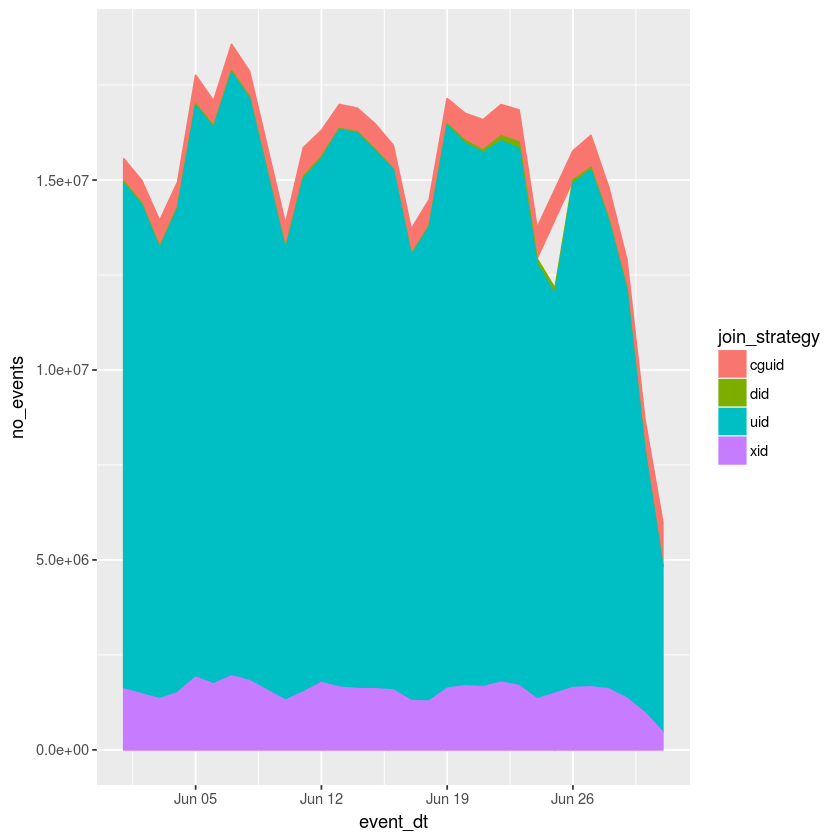

In [14]:
ggplot(data = d,
       aes(x = event_dt,
           y = no_events,
           group = join_strategy,
           fill = join_strategy,
           colour = join_strategy)) + 
    geom_area()

In [17]:
mktng_events_txns_df <- left_join(mktng_events_txns_df, channels_lookup)

Joining, by = "channel_id"
Warning message in left_join_impl(x, y, by$x, by$y, suffix$x, suffix$y):
“joining factors with different levels, coercing to character vector”

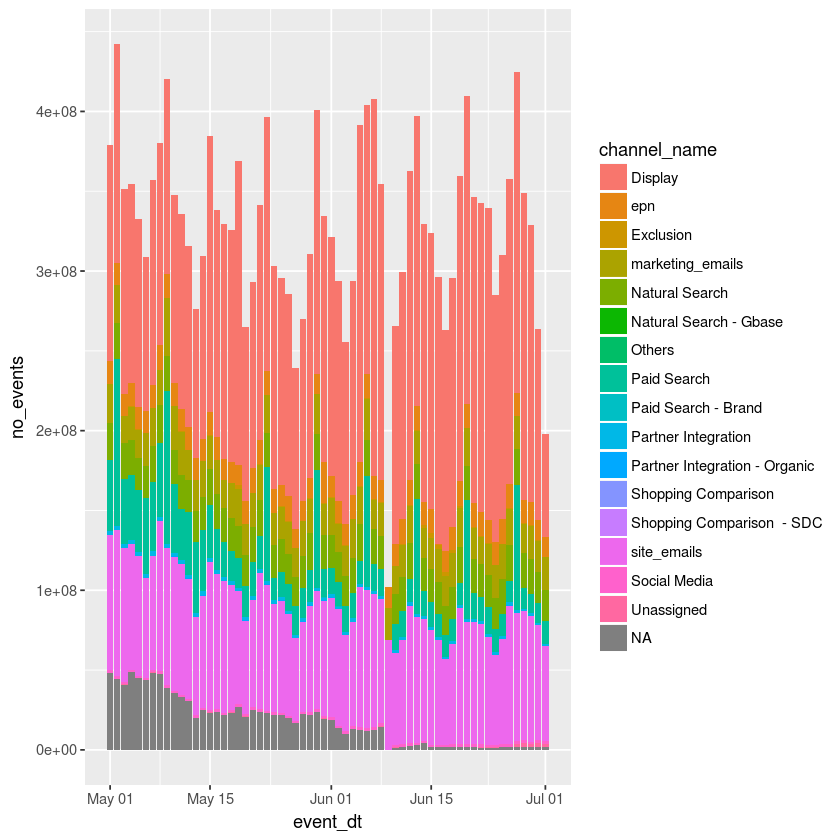

In [18]:
d <- mktng_events %>% 
        select(-event_type_id, channel_id) %>% 
        group_by(event_dt, channel_name) %>% 
        summarise(no_events = sum(no_events))

ggplot(d, aes(x = event_dt, y = no_events, fill = channel_name)) +
    geom_bar(stat='identity')

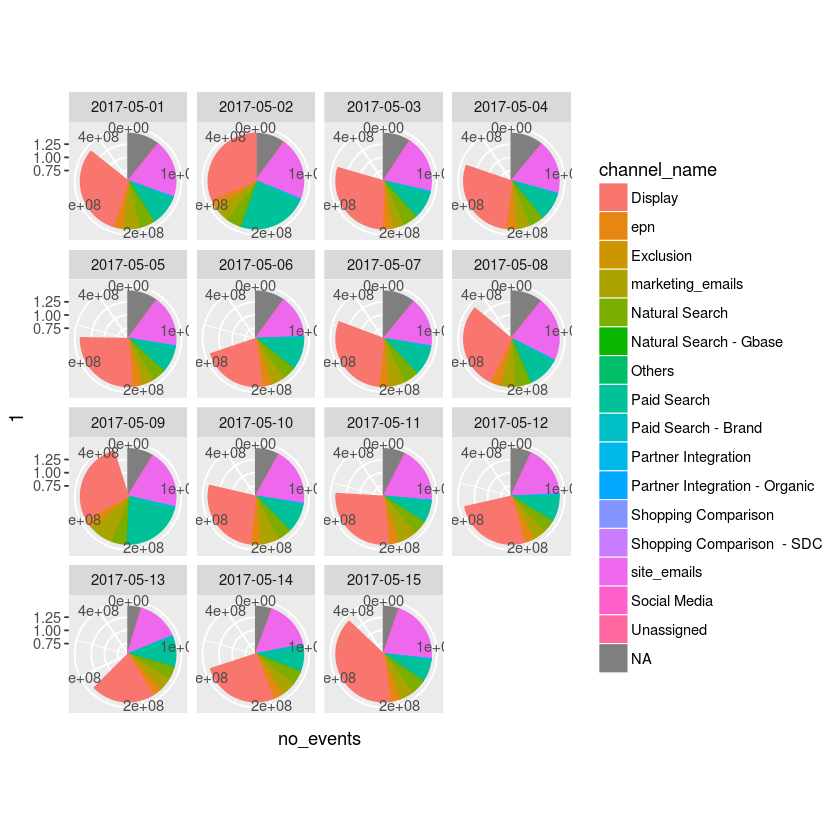

In [45]:
d <- mktng_events %>% 
        select(-event_type_id, channel_id) %>% 
        group_by(event_dt, channel_name) %>% 
        summarise(no_events = sum(no_events)) %>%
        filter(event_dt <= as.Date("2017-05-15"))
        

ggplot(d, 
       aes(x = 1, 
           y = no_events, 
           fill = channel_name, 
           colour = channel_name, 
           group = channel_name)) +
    geom_col() +
    coord_polar(theta = "y") +
    facet_wrap(~ event_dt)

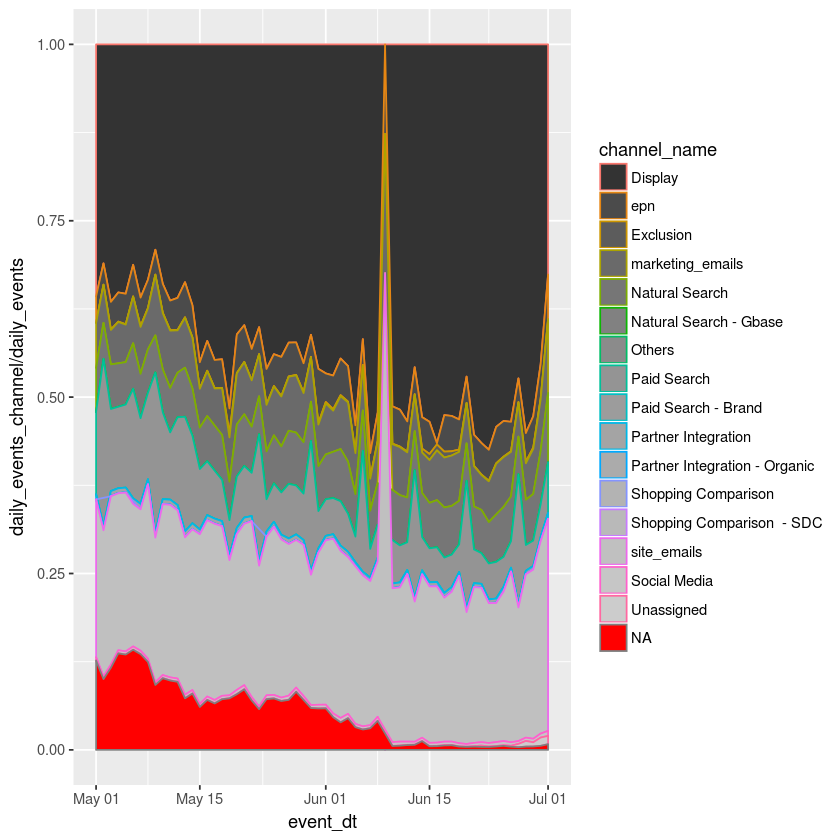

In [82]:
d <- mktng_events %>% 
        select(-event_type_id, channel_id) %>% 
        group_by(event_dt, channel_name) %>% 
        summarise(daily_events_channel = sum(no_events)) %>%
        ungroup(channel_name) %>%
        group_by(event_dt) %>%
        mutate(daily_events = sum(daily_events_channel))

ggplot(d, 
       aes(x = event_dt, 
           y = daily_events_channel/daily_events, 
           fill = channel_name, 
           colour = channel_name, 
           group = channel_name)) +
    geom_area() +
    scale_fill_grey() #+
    #scale_colour_grey()

In [23]:
d

event_dt,channel_name,daily_events_channel,daily_events
2017-06-01,Display,11292586,13956572
2017-06-01,epn,629,13956572
2017-06-01,Exclusion,18034,13956572
2017-06-01,Natural Search,910141,13956572
2017-06-01,Others,6,13956572
2017-06-01,Paid Search,197134,13956572
2017-06-01,Paid Search - Brand,237,13956572
2017-06-01,Partner Integration,446751,13956572
2017-06-01,Partner Integration - Organic,26702,13956572
2017-06-01,Social Media,55779,13956572


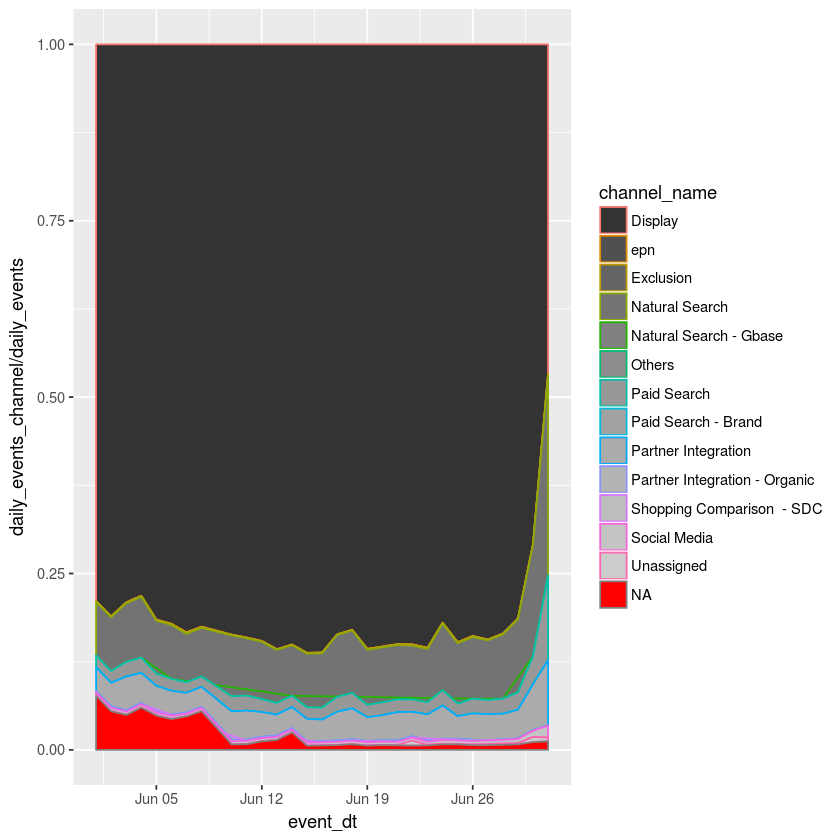

In [22]:
d <- mktng_events_txns_df %>% 
        select(-event_type_id, channel_id) %>% 
        group_by(event_dt, channel_name) %>% 
        summarise(daily_events_channel = sum(no_events)) %>%
        ungroup(channel_name) %>%
        group_by(event_dt) %>%
        mutate(daily_events = sum(daily_events_channel))

ggplot(d, 
       aes(x = event_dt, 
           y = daily_events_channel/daily_events, 
           fill = channel_name, 
           colour = channel_name, 
           group = channel_name)) +
    geom_area() +
    scale_fill_grey() #+
    #scale_colour_grey()